In [1]:
import pandas as pd
import boto3

from pandasgui import show
from boto3.dynamodb.conditions import Key, Attr

In [2]:
dynamodb = boto3.resource('dynamodb')
table = dynamodb.Table('ads_passenger_processed')

In [3]:
res = table.query(
    IndexName='groupMetadataID-index',
    KeyConditionExpression=Key('groupMetadataID').eq('c335d84c-a45c-11ee-88ec-eb6a8d5269b4'),
    Limit = 500,
    FilterExpression = Attr('topic').eq('/apollo/sensor/gnss/best_pose')
)

df=pd.DataFrame.from_dict(pd.json_normalize(res['Items']), orient='columns')
done = False
leek = res["LastEvaluatedKey"]
keywords = {
    "IndexName":'groupMetadataID-index',
    "KeyConditionExpression":Key('groupMetadataID').eq('c335d84c-a45c-11ee-88ec-eb6a8d5269b4'),
    "ExclusiveStartKey": leek,
    "Limit":500,
    "FilterExpression":Attr('topic').eq('/apollo/sensor/gnss/best_pose'),
}

while not done:
    try:
        leek = res["LastEvaluatedKey"]
        print(leek)
        keywords["ExclusiveStartKey"] = leek
        res = table.query(**keywords)
        tmpDF = pd.DataFrame.from_dict(pd.json_normalize(res['Items']), orient='columns')
        df = pd.concat([df, tmpDF])
    except KeyError:
        print("done querying")
        done = True

{'_id': '3d540124-a4ef-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695054918482348696')}
{'_id': '0e6d3294-a4fe-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695055915535331059')}
{'_id': '1cf55de0-a4ee-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695054840352483712')}
{'_id': 'be2bb614-a503-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695056291383154402')}
{'_id': '9c363f78-a4eb-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695054667432289985')}
{'_id': '6c44cc74-a4fe-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Decimal('1695055942082964191')}
{'_id': 'fd648d50-a4fb-11ee-88ec-eb6a8d5269b4', 'groupMetadataID': 'c335d84c-a45c-11ee-88ec-eb6a8d5269b4', 'time': Dec

In [24]:
show(df)

PandasGUI INFO — pandasgui.gui — Opening PandasGUI
/tmp/ipykernel_30478/1525291607.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  show(df)
/tmp/ipykernel_30478/1525291607.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  show(df)
/tmp/ipykernel_30478/1525291607.py:1: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/tmp/ipykernel_30478/1525291607.py:1: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. 

In [5]:
from datetime import datetime
from decimal import Decimal

In [17]:
#Sort the time column
time = df.sort_values(by=["time"])

In [18]:
#Set the time column to type float
time["time"]=time["time"].astype(float)

In [21]:
#Converts the epoch time to a standard M-D-Y standard (military)time 
time["time"]=time["time"].astype('datetime64[ms]')

In [23]:
#Displays the updated time column
time[["time"]]

,time
0,2023-09-18 16:26:04.043
0,2023-09-18 16:26:05.042
0,2023-09-18 16:26:06.039
0,2023-09-18 16:26:07.043
1,2023-09-18 16:26:08.041
...,...
0,2023-09-18 16:58:21.039
0,2023-09-18 16:58:22.045
1,2023-09-18 16:58:23.036
1,2023-09-18 16:58:24.039


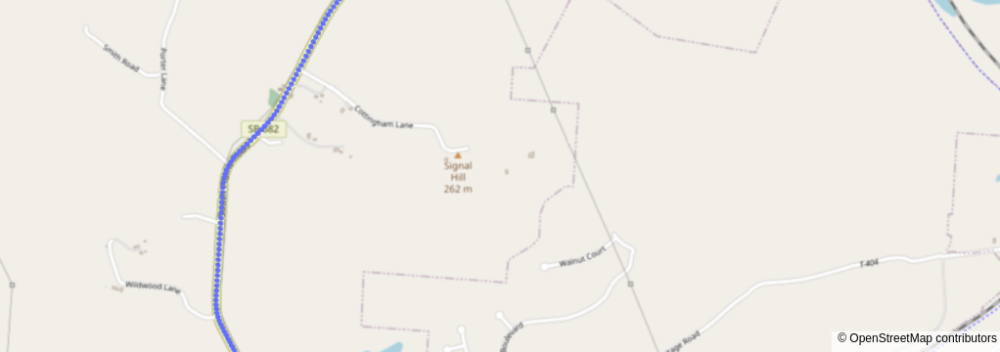

In [36]:
#test map for a simple gnss best pose topic

#Import plotly.express to utilize map
import plotly.express as px


#Define your map with your dataframe name first and keep everything else the same
fig = px.scatter_mapbox(time, lat="latitude", lon="longitude", 
                        hover_data=["time"], zoom=14, height=350)

#Layout settings
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

#Display the map
fig.show()

In [29]:
test = pd.read_csv("testMap.csv")

/home/amicco_linux/do-env/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



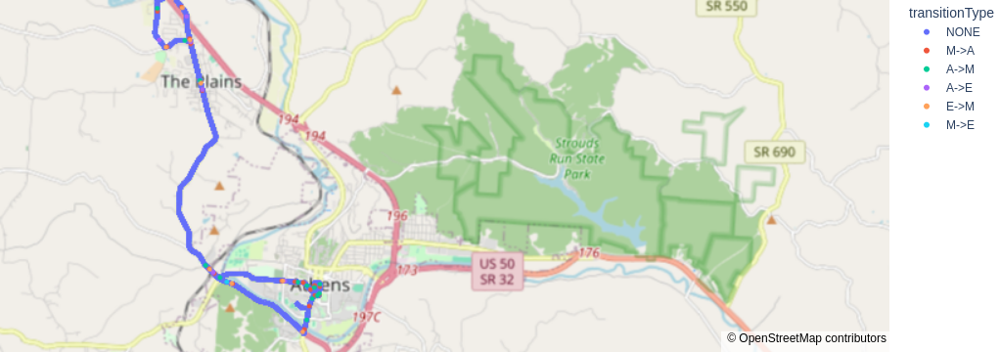

In [38]:
#Test map for combined chassis and gnss best pose dataframes

#Import plotly.express to utilize map
import plotly.express as px

#Define your map with your dataframe name first and keep everything else the same
fig = px.scatter_mapbox(test, lat="latitude", lon="longitude", 
                        hover_data=["time","transitionType"], color="transitionType", zoom=14, height=350)

#Layout settings
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

#Display the map
fig.show()

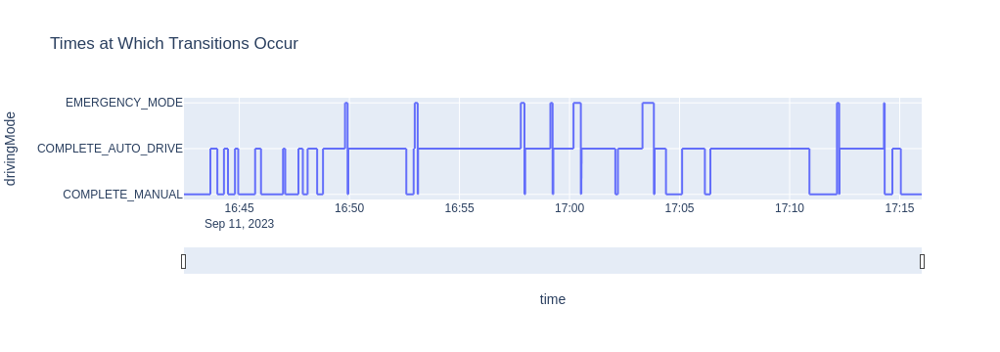

In [41]:
#Using the time series plot to times at which transitions occur
fig = px.line(test, x='time', y='drivingMode', title='Times at Which Transitions Occur')
fig.update_xaxes(rangeslider_visible=True)
fig.show()